# Colleted Data Vizualization 

Observation and Verification of the collected data

In [11]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation

In [13]:
# Load the saved dataset in a_files
data = np.load("a_files/dataset.npz")

# List all arrays stored inside
print(data.files)

['position_list', 'r_list', 'cab_pos_list', 'act_list']


In [14]:
# Access specific arrays
pos_list = data["position_list"]
r_list = data["r_list"]
cab_pos_list = data["cab_pos_list"]
act_list = data["act_list"]

# Print shape to verify
print("Position List Shape:", pos_list.shape)
print("Rotation List Shape:", r_list.shape)
print("Cab Position List Shape:", cab_pos_list.shape)
print("Actuation List Shape:", act_list.shape)

Position List Shape: (9000, 4, 3)
Rotation List Shape: (9000, 4, 3, 3)
Cab Position List Shape: (9000, 3, 3)
Actuation List Shape: (9000, 3, 3)


In [21]:
print(cab_pos_list)

[[[ 9999.  9995.  9995.]
  [ 9995.  9998.  9998.]
  [ 9997.  9996.  9997.]]

 [[ 9995.  9995.  9995.]
  [ 9995.  9998.  9998.]
  [ 9997.  9996.  9997.]]

 [[ 9886. 10161.  9936.]
  [10100.  9821. 10053.]
  [ 9885. 10161.  9934.]]

 ...

 [[ 9430.  8715. 11821.]
  [10467. 11218.  8297.]
  [ 9036. 10418. 10527.]]

 [[ 9365.  8787. 11820.]
  [10234. 11296.  8446.]
  [ 9092. 10342. 10550.]]

 [[ 9431.  8829. 11702.]
  [10261. 11327.  8381.]
  [ 9167. 10301. 10528.]]]


In [20]:
print(act_list)

[[[    0.     0.     0.]
  [    0.     0.     0.]
  [    0.     0.     0.]]

 [[ -118.   185.   -67.]
  [ -118.   185.   -67.]
  [ -118.   185.   -67.]]

 [[ -202.   128.    74.]
  [ -202.   128.    74.]
  [ -202.   128.    74.]]

 ...

 [[ -633. -1199.  1832.]
  [ -236. -1315.  1551.]
  [ -914.   349.   565.]]

 [[ -554. -1155.  1709.]
  [ -273. -1345.  1618.]
  [ -837.   309.   528.]]

 [[ -508. -1207.  1715.]
  [ -414. -1277.  1691.]
  [ -929.   275.   654.]]]


In [5]:
# Color:
# base: black
# section1 : blue
# section2 : green
# section3 : red
colors = ["black", "blue", "green", "red"]

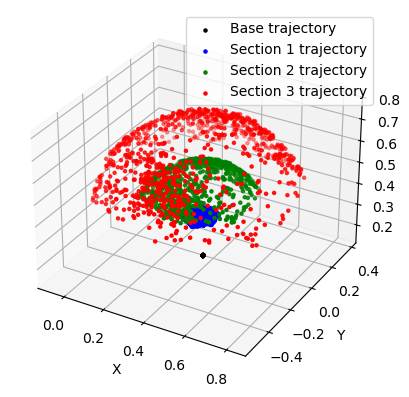

In [6]:
# Create figure
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Define step size
step = 10  

# Plot scatter points for each section
ax.scatter(pos_list[::step, 0, 0], pos_list[::step, 0, 1], pos_list[::step, 0, 2], 
           color='black', s=5, label='Base trajectory')

ax.scatter(pos_list[::step, 1, 0], pos_list[::step, 1, 1], pos_list[::step, 1, 2], 
           color='blue', s=5, label='Section 1 trajectory')

ax.scatter(pos_list[::step, 2, 0], pos_list[::step, 2, 1], pos_list[::step, 2, 2], 
           color='green', s=5, label='Section 2 trajectory')

ax.scatter(pos_list[::step, 3, 0], pos_list[::step, 3, 1], pos_list[::step, 3, 2], 
           color='red', s=5, label='Section 3 trajectory')

# Set labels
ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_zlabel("Z")
ax.legend()

plt.show()


In [10]:
# Create an interactive 3D plot using Plotly

# Define step size
step = 1

# Create 3D scatter plot
fig = go.Figure()

# Base trajectory
fig.add_trace(go.Scatter3d(
    x=pos_list[::step, 0, 0], 
    y=pos_list[::step, 0, 1], 
    z=pos_list[::step, 0, 2], 
    mode='markers', 
    marker=dict(color='black', size=3),
    name="Base trajectory"
))

# Section 1 trajectory
fig.add_trace(go.Scatter3d(
    x=pos_list[::step, 1, 0], 
    y=pos_list[::step, 1, 1], 
    z=pos_list[::step, 1, 2], 
    mode='markers', 
    marker=dict(color='blue', size=3),
    name="Section 1 trajectory"
))

# Section 2 trajectory
fig.add_trace(go.Scatter3d(
    x=pos_list[::step, 2, 0], 
    y=pos_list[::step, 2, 1], 
    z=pos_list[::step, 2, 2], 
    mode='markers', 
    marker=dict(color='green', size=3),
    name="Section 2 trajectory"
))

# Section 3 trajectory
fig.add_trace(go.Scatter3d(
    x=pos_list[::step, 3, 0], 
    y=pos_list[::step, 3, 1], 
    z=pos_list[::step, 3, 2], 
    mode='markers', 
    marker=dict(color='red', size=3),
    name="Section 3 trajectory"
))

# Update layout for better visualization
fig.update_layout(
    scene=dict(
        xaxis_title="X",
        yaxis_title="Y",
        zaxis_title="Z"
    ),
    margin=dict(l=0, r=0, b=0, t=40)
)

# Show interactive figure
fig.show()


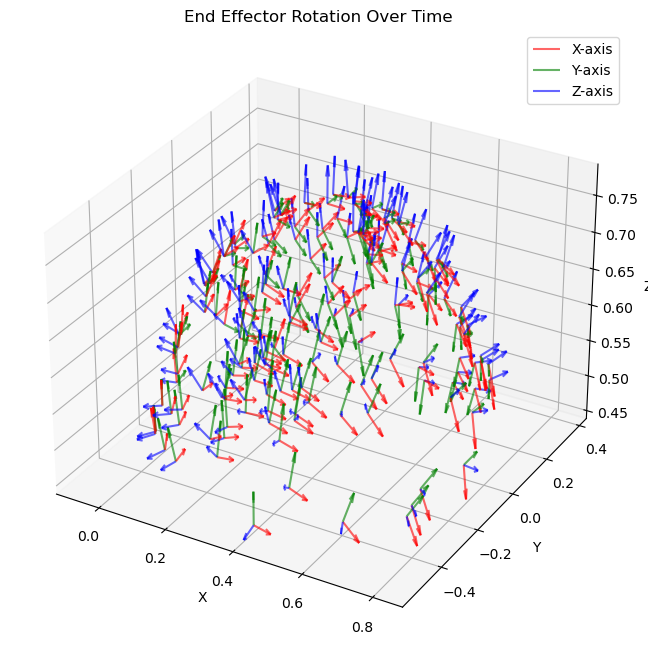

In [8]:
# Show angles of the end effector over time
step = 50
frames = np.arange(0, 9000, step)

fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')

# only the end effector
for t in frames:
    origin = pos_list[t, 3]
    R = r_list[t, 3]  # 3x3 rotation matrix

    # X, Y, Z axes of the segment
    ax.quiver(*origin, *R[:, 0], length=0.05, color='r', alpha=0.6)  # x-axis
    ax.quiver(*origin, *R[:, 1], length=0.05, color='g', alpha=0.6)  # y-axis
    ax.quiver(*origin, *R[:, 2], length=0.05, color='b', alpha=0.6)  # z-axis

ax.set_title("End Effector Rotation Over Time")
ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_zlabel("Z")
ax.legend(["X-axis", "Y-axis", "Z-axis"])
plt.show()

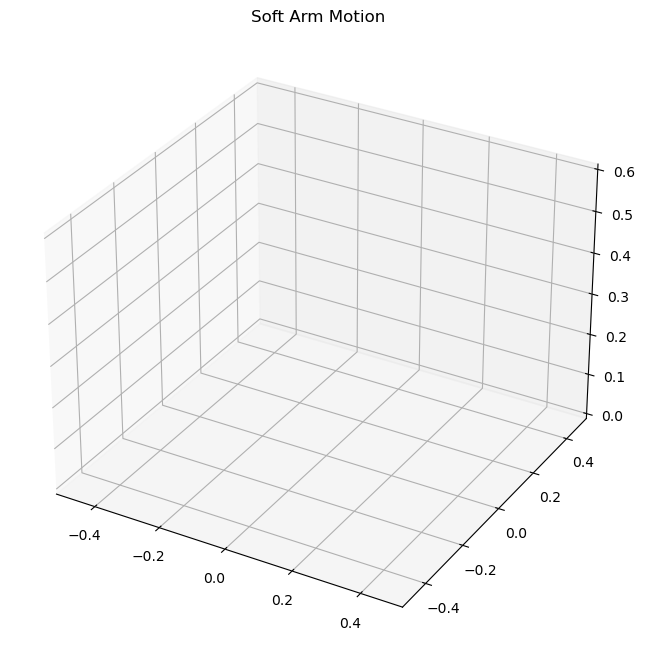

In [9]:
# Animate the soft arm motion

step = 10
frames = range(0, len(pos_list), step)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

skeleton_line, = ax.plot([], [], [], 'k-o', lw=2)
quiver_plots = []

def init():
    ax.set_xlim([-0.5, 0.5])
    ax.set_ylim([-0.5, 0.5])
    ax.set_zlim([0, 0.6])
    ax.set_title("Soft Arm Motion")
    return skeleton_line,

def update(frame):
    global quiver_plots
    for q in quiver_plots:
        q.remove()
    quiver_plots.clear()

    # Update skeleton
    pts = pos_list[frame]
    skeleton_line.set_data(pts[:, 0], pts[:, 1])
    skeleton_line.set_3d_properties(pts[:, 2])

    # Draw coordinate axes
    for i in range(4):
        origin = pts[i]
        R = r_list[frame, i]
        for col, color in zip(range(3), ['r', 'g', 'b']):
            vec = R[:, col] * 0.05
            q = ax.quiver(*origin, *vec, color=color)
            quiver_plots.append(q)

    return skeleton_line, *quiver_plots

ani = FuncAnimation(fig, update, frames=frames, init_func=init, blit=False, interval=50)

anim = ani  # Store in a global variable

In [13]:
# show animaition in jupyter notebook
from IPython.display import HTML
HTML(ani.to_jshtml())

Animation size has reached 21086703 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
